In [260]:
print

<function print>

In [261]:
my_var=10

In [262]:
print(my_var)

10


In [263]:
print(id(my_var))

4302809680


In [264]:
print(hex(id(my_var)))

0x10077aa50


In [265]:
import sys


In [266]:
a = [1,2,3]

In [267]:
id(a)

4435233536

In [268]:
sys.getrefcount(a)

2

In [269]:
import ctypes
import gc

In [270]:
print(ctypes.c_long.from_address(id(a)).value)

1


Circular references are created when object1 points object2 and object2 points object1, both of them are not deleted by **python memory manager**

**Garbage collector** identifies memory leaks

In [271]:
def ref_count(address):
    return ctypes.c_long.from_address(address).value

def object_by_id(object_id):
    for obj in gc.get_objects():
        if id(obj) == object_id:
            return "Object exists"
    return "Not Found"    
    

In [272]:
class A:
    def __init__(self):
        self.b = B(self)
        print('A: self: {0} , b: {1}'.format(hex(id(self)), hex(id(self.b))))

In [273]:
class B:
    def __init__(self,a):
        self.a = a
        print('B: self: {0}, a: {1}'.format(hex(id(self)), hex(id(self.a))))

In [274]:
gc.disable()


In [275]:
my_var = A()

B: self: 0x1080f39a0, a: 0x1080f39d0
A: self: 0x1080f39d0 , b: 0x1080f39a0


In [276]:
a_id = id(my_var)
b_id = id(my_var.b)

In [277]:
print(hex(a_id))
print(hex(b_id))

0x1080f39d0
0x1080f39a0


In [278]:
ref_count(a_id)

2

In [279]:
ref_count(b_id)


1

In [280]:
my_var = None

In [281]:
ref_count(a_id)

1

In [282]:
ref_count(b_id)

1

In [283]:
object_by_id(a_id)

'Object exists'

In [284]:
object_by_id(b_id)

'Object exists'

In [285]:
gc.collect()

6773

In [286]:
object_by_id(a_id)

'Not Found'

In [287]:
object_by_id(b_id)

'Not Found'

In [288]:
 a = 'hello'

In [289]:
type(a)

str

In [290]:
a=107758

In [291]:
type(a)

int

In [292]:
a = lambda x:x**4

In [293]:
a(2)

16

In [294]:
type(a)

function

In [295]:
a=10

In [296]:
id(a)

4302809680

In [297]:
a=15

In [298]:
id(a)

4302809840

In [299]:
b=15
id(b)

4302809840

Mutable and immutable objects

Numbers, strings, tuples, Frozen sets, user defined classes are immutable
Lists, sets, dictionary, user defined classes are mutable

In [300]:
def process(s):
    print('Initial S # = {0}'.format(id(s)))
    s = s + ' world'
    print('Final S # = {0}'.format(id(s)))

In [301]:
my_var = 'hello'
print('my_var # = {0}'.format(id(my_var)))

my_var # = 4354580528


In [302]:
process(my_var)

Initial S # = 4354580528
Final S # = 4435166704


In [303]:
my_var

'hello'

In [304]:
id(my_var)

4354580528

In [305]:
def modify_lst(lst):
    print('Initial lst # = {0}'.format(id(lst)))
    lst.append(100)
    print('Final lst # = {0}'.format(id(lst)))

In [306]:
my_list = [1,2,3]
id(my_list)

4433062848

In [307]:
modify_lst(my_list)

Initial lst # = 4433062848
Final lst # = 4433062848


In [308]:
a = [1,2,3]
b = [1,2,3]

In [309]:
id(a)

4433004608

In [310]:
id(b)

4361529408

While dealing with mutable objects, python memory manager creates separate objects even when different objects are getting defined by the same value, whereas while defining same immutable object to different variables, the variable references point to the same object.

'is' operate compares the memory addresses
whereas '==' compares the object state


None is a object in python, when a variable is assigned none, it is assigned the reference address pointing to the none object.

In [311]:
id(None)

4310907472

In [312]:
a =None
b=None
c=None

In [313]:
a is None

True

since, everything we see in python is objects, everything has a reference address that can be assigned to a variable, or passed to a function as parameter.

note:
while passing a function as a parameter to some other function, '()' shouldn,t be used, as it invokes the function. without paranthesis it's the name of function and with paranthesis it's a call to function


In [314]:
help(int)

Help on class int in module builtins:

class int(object)
 |  int([x]) -> integer
 |  int(x, base=10) -> integer
 |  
 |  Convert a number or string to an integer, or return 0 if no arguments
 |  are given.  If x is a number, return x.__int__().  For floating point
 |  numbers, this truncates towards zero.
 |  
 |  If x is not a number or if base is given, then x must be a string,
 |  bytes, or bytearray instance representing an integer literal in the
 |  given base.  The literal can be preceded by '+' or '-' and be surrounded
 |  by whitespace.  The base defaults to 10.  Valid bases are 0 and 2-36.
 |  Base 0 means to interpret the base from the string as an integer literal.
 |  >>> int('0b100', base=0)
 |  4
 |  
 |  Built-in subclasses:
 |      bool
 |  
 |  Methods defined here:
 |  
 |  __abs__(self, /)
 |      abs(self)
 |  
 |  __add__(self, value, /)
 |      Return self+value.
 |  
 |  __and__(self, value, /)
 |      Return self&value.
 |  
 |  __bool__(self, /)
 |      self != 

In [315]:
def square(a):
    return a**2


In [316]:
type(square)

function

In [317]:
id(square)

4434944208

In [318]:
f = square

In [319]:
id(f)

4434944208

In [320]:
f is square

True

In [321]:
f(2)

4

In [322]:
def cube(a):
    return a**3

In [323]:
def select_func(fn_id):
    if fn_id == 1:
        return square
    else:
        return cube

In [324]:
select_func(1)(2)

4

In [325]:
id(select_func(1))

4434944208

In [326]:
select_func(2)(4)

64

In [327]:
def exec_function(fn,n):
    return fn(n+1)


In [328]:
exec_function(square,3)

16

singleton objects are classes that can be initiated only once, so when we try to reinitiate them, they are referenced to the same address

numbers in the range -5 to 256 are pre loaded in pyhton so, whenever they are refernced it refernces to this pre loaded addresses

In [329]:
a =10
b=10

In [330]:
a is b

True

In [331]:
c=257
d=257

In [332]:
c is d

False

interning means python by default will keep a copy of the interned element and whenever needed, it will refernce the address of that interned element as many times as possible. this reduces the time and memory exhaustion in creating different instances while dealing with equal value objects

Strings can be interned in python

In [333]:
import sys

In [334]:
a = sys.intern('My name is Tanay')

In [335]:
b = sys.intern('My name is Tanay')

In [336]:
a is b

True

In [337]:
a = 'hellosihbsiuabfuyybfybfibib'
b='hellosihbsiuabfuyybfybfibib'
a is b

True

Generally a string without spaces gets interned
large number of comparision of strings is better to be done by interning

In [338]:
print(type(100))

<class 'int'>


In [339]:
import sys

In [340]:
sys.getsizeof(0)

24

In [341]:
sys.getsizeof(1)


28

In [342]:
sys.getsizeof(100)


28

In [343]:
sys.getsizeof(1000000000000000**200000)

1328796

In [344]:
import time
def calc(a):
    return 2**a

In [345]:
start = time.perf_counter()
calc(10)
end = time.perf_counter()
print(end - start)

2.2166999769979157e-05


In [346]:
start = time.perf_counter()
calc(10000)
end = time.perf_counter()
print(end - start)

4.2333000237704255e-05


In [347]:
155 // 4

38

In [348]:
155%4

3

In [349]:
38*4 + 3

155

a/b = a//b + a%b

this condition needs to be satisfied in any kind of divisions
a//b -> this is floor of a/b (not necessarily quotient of a/b)
a%b -> this is calculated from the above equation. and not necessarily a reminder in a/b.

In [350]:
type(1+1)

int

In [351]:
type(2/3)

float

In [352]:
type(10/2)

float

In [353]:
import math

In [354]:
math.floor(3.99999)

3

floor has a limited precision

In [355]:
math.floor(-3.000000000001)

-4

In [356]:
math.floor(-3.0000000000000001)

-3

In [357]:
a=33
b=16
print(a/b)
print(a//b)
print(a%b)

2.0625
2
1


In [358]:
a=-33
b=16
print(a/b)
print(a//b)
print(a%b)

-2.0625
-3
15


In [359]:
a=-33
b=-16
print(a/b)
print(a//b)
print(a%b)

2.0625
2
-1


Bin() function is used to convert decimal to base 2
oct() to base 8
hex() to base 16

apart from this if we want to represent the number in any other base, we'll need custom code for it.

--------------------start of peephole optimisation-----------------------

# peephole optimisation

During peephole optimisation, optimisation occures at compile time. 
in that constant expressions, upto a certain limit gets stored into the resulting constants

## Membership tests

during membership tests:
lists->tuples
sets->Frozen sets
Set memberships are much faster than list or tuple membership, because sets are basically like doctionairies

In [360]:
def my_func():
    a =24*65
    b= (1,2)*5
    c='abc'*100
    d = 'ab'*20
    e = 'The quick brown fox'*20
    f = ['a','b']*3 

In [361]:
my_func.__code__.co_consts

(None,
 1560,
 (1, 2, 1, 2, 1, 2, 1, 2, 1, 2),
 'abcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabcabc',
 'abababababababababababababababababababab',
 'The quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown foxThe quick brown fox',
 'a',
 'b',
 3)

In [362]:
def my_func(e):
    if e in {1,2,3}:
        pass

In [363]:
my_func.__code__.co_consts

(None, frozenset({1, 2, 3}))

In [364]:
import string
import time

In [365]:
string.ascii_letters

'abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ'

In [366]:
char_list = list(string.ascii_letters)
char_tuple = tuple(string.ascii_letters)

In [367]:
char_set = set(string.ascii_letters)

In [368]:
print(char_list)

['a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']


In [369]:
print(char_tuple)

('a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z')


In [370]:
print(char_set)

{'y', 'O', 'x', 'j', 'u', 'f', 'g', 'h', 'C', 'i', 'o', 't', 'd', 'Z', 'I', 'n', 'B', 'b', 'Q', 'S', 'p', 'e', 'l', 'J', 'V', 'm', 'F', 'q', 'G', 'X', 's', 'A', 'k', 'a', 'v', 'r', 'N', 'w', 'W', 'Y', 'U', 'c', 'M', 'P', 'E', 'K', 'z', 'T', 'R', 'H', 'L', 'D'}


In [371]:
def membership_test(n, container):
    for i in range(n):
        if 'z' in container:
            pass

In [372]:
start = time.perf_counter()
membership_test(10000000, char_list)
end = time.perf_counter()
print('list: ',end - start)

list:  2.3327850830009993


In [373]:
start = time.perf_counter()
membership_test(10000000, char_tuple)
end = time.perf_counter()
print('tuple: ',end - start)

tuple:  2.2606787079985224


In [374]:
start = time.perf_counter()
membership_test(10000000, char_set)
end = time.perf_counter()
print('set: ',end - start)

set:  0.17472258400084684


> # conclusion
> prefer using set membership

-----------------end of peephole optimisation-------------------------

------------------------INtegers : Constructor and bases------------------------

bin(36)

In [375]:
bin(13)

'0b1101'

In [376]:
hex(326)

'0x146'

In [377]:
oct(6)

'0o6'

In [378]:
def from_base10(n,b):
    if b<2:
        raise ValueError("base cannot be lesser than 2")
    if n<0:
        raise ValueError('N has to be positive')
    if n == 0:
        return [0]
    digits = []

    while (n!=0):
        n,m = divmod(n,b)
        # m = n%b
        # n = n // b
        digits.insert(0,m)
    return digits

In [379]:
from_base10(255,2)

[1, 1, 1, 1, 1, 1, 1, 1]

In [380]:
def encode(digits, digits_map):
    if max(digits) >= len(digits_map):
        raise ValueError("digit map isn't long enough to encode the digits" )
    # encoding = ''
    # for d in digits:
    #     encoding += digits_map[d]
    # return encoding

    return ''.join(digits_map[d] for d in digits)

In [381]:
encode([15,4], '0123456789abcdef')

'f4'

In [382]:
def rebase_from10(n,b):
    digits_map = '0123456789ABCDEFGHIJKLMNOPQRSTUVWXYZ'
    if b<2 or b>36:
        raise ValueError('base is not in the legel range')
    sign = -1 if n<0 else 1
    n *= sign
    digits = []
    while(n!=0):
        n,m = divmod(n,b)
        digits.insert(0,m)
    ans = ''.join(digits_map[d] for d in digits)
    if(sign == -1):
        ans = '-'+ans
    return ans

In [383]:
rebase_from10(-99988,15)

'-1E95D'

In [384]:
from fractions import Fraction

In [385]:
x = Fraction(3.142857142857143)
x

Fraction(7077085128725065, 2251799813685248)

In [386]:
float(Fraction(22,7))

3.142857142857143

In [387]:
import math

In [388]:
x = Fraction(math.pi)
x = x.limit_denominator(10)
print(x)

22/7


------------------------------Floats internal representation---------------------------
All floats when stored in computer are interpreted in base 2 system. Because of this reason even if some floats seems to be exact in base 10, when represented in base 2, are not exact.

In [389]:
a = 0.1+0.1+0.1
b=0.3
print(a==b)

False


In [390]:
format(a,'.25f')

'0.3000000000000000444089210'

In [391]:
format(b,'.25f')

'0.2999999999999999888977698'

----------------floats equality testing-----------------

## method 1 

using `round()`

but in round we are looking for absolute tolerance, which can be invalid when the order/size of number is either very large or very small.
for such conditions we need to coin a method which uses tolerance relative to the size of 

In [392]:
round(0.1,5)+round(0.1,5)+round(0.1,5) == round(0.3,5)

False

In [393]:
round(0.1+0.1+0.1,5) == round(0.3,5)

True

## method 2

specify a range '*E*', and if the difference between 2 floats is lesser than that, they are equal

i.e. |a-b|<E

> # conclusion :
> while dealing with floating point numbers, we have to use `islcose()` method of math module

`math.isclose(x,y,*,rel_tot = ,abs_tot = )`

In [394]:
import math
print(math.isclose(10.00005,10.00006,rel_tol=1e-25,abs_tol=1e-5))

True


In [395]:
help(math.isclose)

Help on built-in function isclose in module math:

isclose(a, b, *, rel_tol=1e-09, abs_tol=0.0)
    Determine whether two floating point numbers are close in value.
    
      rel_tol
        maximum difference for being considered "close", relative to the
        magnitude of the input values
      abs_tol
        maximum difference for being considered "close", regardless of the
        magnitude of the input values
    
    Return True if a is close in value to b, and False otherwise.
    
    For the values to be considered close, the difference between them
    must be smaller than at least one of the tolerances.
    
    -inf, inf and NaN behave similarly to the IEEE 754 Standard.  That
    is, NaN is not close to anything, even itself.  inf and -inf are
    only close to themselves.



### floats Coercing to integer

4 methods (all have to be imported from math module `import math`)

- `trunc()`
- `floor()`
- `ceil()`
- `round()`

# `round()`

## incase of tie (1.25, 1.35 etc (rounding to one decimal point))

- rounding away from zero (context number line)
- rounding towards zero (context number line)

> Rounding incase of tie is done by going towards the nearest even number

In [396]:
help(round)

Help on built-in function round in module builtins:

round(number, ndigits=None)
    Round a number to a given precision in decimal digits.
    
    The return value is an integer if ndigits is omitted or None.  Otherwise
    the return value has the same type as the number.  ndigits may be negative.



`round(number, n)` -> 'n' gives the number of decimal places that should exist in the result. It basically considers 10^(-n) as a multiplying factor and keeps only that many decimal digits imn the result

It's called **banker's rounding**

In [397]:
import math

In [398]:
help(math.copysign)

Help on built-in function copysign in module math:

copysign(x, y, /)
    Return a float with the magnitude (absolute value) of x but the sign of y.
    
    On platforms that support signed zeros, copysign(1.0, -0.0)
    returns -1.0.



> It copies the sign of the second argument and, pastes it to the first one

so we can use copysign(1,x), for rounding algo

In [399]:
def round_up(x):
    return int(x + math.copysign(1,x)*0.5)

In [400]:
round_up(14.5)

15

In [401]:
a = round(1.9,0)
a, type(a)

(2.0, float)

In [402]:
print(round(111.88888))
print(round(111.88888,4))
print(round(111.88888,2))
print(round(111.88888,0))
print(round(111.88888,-1))    
print(round(111.88888,-2))

112
111.8889
111.89
112.0
110.0
100.0


In [403]:
round(1.25,1), round(1.35,1)

(1.2, 1.4)

In [404]:
def _round(x):
    from math import copysign
    return int(x + 0.5*copysign(1,x))

In [405]:
round(2.5), _round(2.5)

(2, 3)

----------------decimal-------------------------

In [406]:
import decimal
help(decimal.getcontext)

Help on built-in function getcontext in module decimal:

getcontext()
    Get the current default context.



In [407]:
help(decimal.localcontext)

Help on built-in function localcontext in module decimal:

localcontext(ctx=None)
    Return a context manager that will set the default context to a copy of ctx
    on entry to the with-statement and restore the previous default context when
    exiting the with-statement. If no context is specified, a copy of the current
    default context is used.



In [408]:
decimal.getcontext()

Context(prec=28, rounding=ROUND_UP, Emin=-999999, Emax=999999, capitals=1, clamp=0, flags=[Inexact, Rounded], traps=[InvalidOperation, DivisionByZero, Overflow])

In [409]:
from decimal import Decimal

In [410]:
decimal.getcontext().rounding = 'ROUND_UP'

FLOATS are stored in base 2 system whereas decimal are stored as base 10 systems, so although we can pass floats to the constructor directly, it is highly recommended that we shouldn't. because it will store the errored value arising due to storage in base 2 system

> hence to store a float we use string, or tuple.

decimals have 3 main data to be stored,
1. Integer part
2. sign
3. power of 10, to mention decimal places

So data stored in decimal is in the form of a tuple

##### (sign, (d1,d2,d3,.....), exp)

In [411]:
a = Decimal((1,(3,1,4,1,5),-4))

In [412]:
a 

Decimal('-3.1415')

# Decimals: Constructor and Context

Context precision affects mathematical operations and not the Decimal constructor

In [413]:
a = Decimal('10.12355555')
b = Decimal('10.12355555')
print(decimal.getcontext().prec)
decimal.getcontext().prec = 6
a + b

28


Decimal('20.2472')

In [414]:
with decimal.localcontext() as ctx:
    ctx.prec = 2
    c = a + b
    print(c)
print(a+b)

21
20.2472


# Decimal: Maths Operations

- For integers -> a//b = `floor(a/b)`
- For Decimals -> a//b = `trunc(a/b)`

For mathematical operations, use the operations defined in the Decimal class, otherwise it will be interpreted as a float. 
- e.g.

In [415]:
decimal.getcontext().prec = 28
x = 0.01
x_dec = Decimal('0.01')
root = math.sqrt(x)
mixed_root = math.sqrt(x_dec)
root_dec = x_dec.sqrt()

In [416]:
print(format(root,'.28f'))
print(format(mixed_root,'.28f'))
print(format(root_dec,'.28f'))

0.1000000000000000055511151231
0.1000000000000000055511151231
0.1000000000000000000000000000


# Decimals: perfomrmance considerations

In [417]:
from decimal import Decimal

In [418]:
import sys

In [419]:
a = 3.1415
b = Decimal('3.1415')

In [420]:
sys.getsizeof(a)

24

In [421]:
sys.getsizeof(b)

104

# COmplex numbers

- `complex` class
- `.real`
- `.imag`
- `.conjugate()`
- //, %, ==, !=, <, >, >=, <= and math module functions are not supported
- `cmath` library to be used for math equivalent operations
-----------cmath funcs-------------------
- `.phase` -> polar angle
- `.abs` -> polar magnitude

# Booleans

In [422]:
issubclass(bool, int)

True

In [423]:
isinstance(True, int)

True

>- `True` and `False` are singleton abjects, means they will be stored to a single memory address throughout the life time of the application
>- ***But*** True and 1 (Also, 0 and False) are not the same objects!!!!

Every class defined in python has it's truth value, means that the `bool()` constructor can be used to extract those truth values from classes and instances

any `int` other than 0 has a truth value of `True`

In [424]:
type(True), id(True), int(True)

(bool, 4310828224, 1)

In [425]:
id(3<4)

4310828224

Object evaluates to truthy value of `True` by default, but in some cases it's not

- None
- False
- 0
- emppty mapping types(dict, sets etc)
- empty classes that implement `__bool__` or `__len__` methods that returns False or 0


Truth values are defined by special methods:
- `__bool__(self)` or `len`

## Booleans: preceding and short circuiting

### Operator precedence:
- ()
- <,>,<=, >=, !=, is, in
- not
- and
- or

X `or` Y -> return X if X is Truthy, else return Y <br>
X `and` Y -> return X if X is Flasy, else return Y 

# Function Parameters

## Argument vs Parameter

- Arguments are passed by reference to the function.

## Positional and keyword argument

 - `def my_func(a,b=100)` -> specified 100 as default value of b
> If a positional parameter has a defined default value, then every parameter after it must also have a default value.
> i.e. `def my_func(a,b=123,c)` -> is invalid!!!!

### keyword arguments
- When parameter names are used to initialise a variable as arguments while calling function it is called keyword arguments.<br>
`def my_func(a,b=10,c=34):` <br>
    `#code` <br>
    `.` <br>
    `.`<br>
    `.`<br>
`my_func(a=3,c=9)`    -> it is the exaple of keyword argument<br>

Once, we use keyword arg. in afunction we should use them only thereafter

In [426]:
def my_func(a,b,c):
    print("{0} {1} {2}".format(a,b,c))

In [427]:
my_func(1,2,3)

1 2 3


In [428]:
def my_func(a,b=2,c):
    print("{0} {1} {2}".format(a,b,c))

SyntaxError: non-default argument follows default argument (1308480979.py, line 1)

In [ ]:
def my_func(a,b,c=2):
    print("{0} {1} {2}".format(a,b,c))

In [ ]:
my_func(b=1)

TypeError: my_func() missing 1 required positional argument: 'a'

## Unpacking iterables

Note: In python a tuple isn't defined by a (), bt by ',' .<br>
i.e. 1,2,3 -> is a tuple -> (1,2,3) <br>

### packed values
- Values stored in Strings, dictionary, lists, tuples, set - are packed value<br>
<p>
Infact, all iterables are packed values<br>
unpacking is done by equating a tuple or a list containing equal numbers of variables as that of the individual elements in the iterable to be unpacked.<br>
<p>

e.g.<br>

`a,b,c = [1,2,3]`


In [ ]:
def swap(a,b):
    b,a = a,b

In [ ]:
x,y=1,2
x,y=y,x

In python entire RHS of a '=' is evaluated first, then it moves to LHS

In [ ]:
x


2

Sets, dictionaries are unordered, so they'll be unpacked in different orders everytime

unpacking incase of dictionary is done only of the keys!<br>
and it is unordered as discussed earlier.<br>
`dict.values()` can be used to create an iterable of the values in a dictionary<br>
`dict.items()` gives tuple of tuples containing the key and the value<br>

In [ ]:
d = ([1,2],[3,4])
for e in d:
    e[1]

### * operator
- it basically reads 'the rest'!
- it can only be used once on the LHS of an assignment
- it unpacks a dictionary when used inside a list. e.g. [*dict1,*dict2] = [*unpacked items of dict1 and dict2*]
- to avoid repetitions it canm also be stored inside set. (sets doen't have repetitions)
- It can also be interpreted as end to positional arguments in the function definition

In [ ]:
#e.g.

d1 = {'p':1, 'y':2, 't':3, 'h': 4}
d2 = {'h':5}
d3 = {'h':1, 'o':6, 'n':7}

In [ ]:
d = {*d1, *d2, *d3}
d

{'h', 'n', 'o', 'p', 't', 'y'}

In [ ]:
c = [3,-99,1]
s = ['d',10,3,-99]
list(c)

[3, -99, 1]

In [ ]:
*c,=s

In [ ]:
c

['d', 10, 3, -99]

In [ ]:
def func_1(a,b,c):
    print(a)
    print(b)
    print(c)

In [ ]:
l = [1,2,3]
func_1(l)

TypeError: func_1() missing 2 required positional arguments: 'b' and 'c'

> - * can be used to unpack list and pass it as an argument to a function.

In [ ]:
l = [1,2,3]
func_1(*l)

1
2
3


### ** operator
- It cannot be used in the LHS of an expression.
- It basically, used to merge 2 or more dictionaries.
- incase of repeating keys, the key present in the last dictionary to be unpacked is considered.
- It is also used to scoop up the keyword arguments when used for passing parameter in the function definition

In [ ]:
#e.g.

d1 = {'p':1, 'y':2, 't':3, 'h': 4}
d2 = {'h':5}
d3 = {'h':1, 'o':6, 'n':7}

In [ ]:
d = {**d1, **d2, **d3}
d

{'p': 1, 'y': 2, 't': 3, 'h': 1, 'o': 6, 'n': 7}

### Nested unpacking

In [ ]:
#e.g.

a,b,(c,d) = [1,2,[3,4]]

In [ ]:
a,b,c,d


(1, 2, 3, 4)

#### exception 

In [ ]:
a, *b, (c, *d) = [1,2,3,4,'python']


In [ ]:
a,b,c,d

(1, [2, 3, 4], 'p', ['y', 't', 'h', 'o', 'n'])

In [ ]:
#slicing

l = [1,2,3,4,'python']

a,*b,(c,*d) = l[0],l[1:4], l[4][0], l[4][1:]

In [ ]:
a = l[0]
b = l[1:4]
c = l[4][0]
d = l[4][1:]


In [ ]:
a,b,c,d

(1, [2, 3, 4], 'p', 'ython')

* & ** operators cannot be used for unordered iterables

## *args

In [ ]:
def hunc_1(a,b,*args):
    print(a)
    print(b)
    print(args)


In [ ]:
hunc_1(10,20)

10
20
()


In [ ]:
hunc_1(1,2,3,4,5,6,7,8,89,7,6655)

1
2
(3, 4, 5, 6, 7, 8, 89, 7, 6655)


In [ ]:
def avg(*args):
    if len(args) > 0:
        return sum(args)/len(args)
    elif len(args) == 0:
        return 0

In [ ]:
print(avg())

0


In [ ]:
def avg(a,*args):
    return sum(1+args)/(len(args)+1)

In [ ]:
print(avg(1))

0.0


## Keyword Arguments

In [ ]:
def func(a,b,c):
    print(a,b,c)

In [ ]:
func(1,2,3)

1 2 3


In [ ]:
func(c=1,a=2,b=3)

2 3 1


In [ ]:
func(2,c=3,b=4)

2 4 3


In [ ]:
def func(a,b,*args):
    print(a,b,args)

In [ ]:
func(1,2,3,4,5,67)

1 2 (3, 4, 5, 67)


In [ ]:
def func(a,b,*args,d):
    print(a,b,args,d)

This makes d as a mandatory keyword argument.<br>
It's because, * specifies end of positional argumnets

In [ ]:
func(1,2,3,4,5,6,d = 7)

1 2 (3, 4, 5, 6) 7


In [ ]:
def func(a,b,*,d):
    print(a,b,d)

- This limited the positional arguments that can be passed to a function to 2, and added a compulsory keyword argument.

In [ ]:
func(1,2,d=5)

1 2 5


In [ ]:
func(1,2,3,4,5,d=6)

TypeError: func() takes 2 positional arguments but 5 positional arguments (and 1 keyword-only argument) were given

In [ ]:
def func(*args,d):
    print(args, d)

- This gives a free hand to the function to take as many positional arguments as possible, but a certain Keyword argument is compulsory

In [ ]:
func(1,2,3,4,5,6)

TypeError: func() missing 1 required keyword-only argument: 'd'

In [ ]:
func(1,2,3,4,5,d = 6)

(1, 2, 3, 4, 5) 6


In [ ]:
func(d=9)

() 9


In [ ]:
def func(*,d):
    print(d)

- This limits the permitted positional arguments = 0, and added a compulory Keyword Argument.

- while using * in parameters while defining a function, we can use undefaulted parameter after '*', even if any parameter before '*' are defaulted.

In [ ]:
def func(a,b=5,*,c):
    print(a,b,c)

In [ ]:
func(1,c=90)

1 5 90


## **args

 - '`*`' is used to scoop up positional arguments, and '`**`' is used to scoop up the keyword arguments
 - Unlike * operator to scoop positional arguments, there is no need to to exhaust all keyword arguments before scooping the remaining keyword args.
- No parameters come after arg.
- `kwargs` will be a `dictionary`

In [ ]:
def func(**kwargs):
    print(kwargs)

In [ ]:
func(a=1,b=2,c=3,d=4)

{'a': 1, 'b': 2, 'c': 3, 'd': 4}


In [ ]:
def func(*args, **kwargs):
    print(args)
    print(kwargs)

In [ ]:
func(1,2,3,4,5,6,f=765,a=43)

(1, 2, 3, 4, 5, 6)
{'f': 765, 'a': 43}


In [ ]:
def func(a,b,*,d,**args):
    print(a)
    print(b)
    print(d)
    print(args)

In [ ]:
func(1,2,d=3,g=7, h=200)

1
2
3
{'g': 7, 'h': 200}


In [ ]:
def func(a,b,**args):
    print(a,b,args)

In [ ]:
func(1,2,p=3,q=5,g=98)

1 2 {'p': 3, 'q': 5, 'g': 98}


In [ ]:
def func(a,b,*args,d,e,**kvargs):
    print(a)
    print(b)
    print(args)
    print(d)
    print(e)
    print(kvargs)

In [ ]:
func(1,2,3,4,5,6,7,r=567,name='tanay', surname = 'Vekariya' ,d=2210, roll = 3407,e='prime')

1
2
(3, 4, 5, 6, 7)
2210
prime
{'r': 567, 'name': 'tanay', 'surname': 'Vekariya', 'roll': 3407}


`print(value, ..., sep=' ', end='\n', file=sys.stdout, flush=False)`

In [ ]:
print(1,2,3,sep=' and ', end= '  bye bye')

1 and 2 and 3  bye bye

In [ ]:
def func(a, b, *args):
    print(a,b,args)

In [ ]:
func(1,2,3,'x','y','z')

1 2 (3, 'x', 'y', 'z')


- when calling a function, one cannot use positional args after using keyword args
- but kwargs can be used

In [ ]:
def func(a, b, c, *args):
    print(a,b,c,args)
    

- When used default positional args, with *args, flexibility of 

In [ ]:
func(1,c=3,6,7)

SyntaxError: positional argument follows keyword argument (3014358902.py, line 1)

In [ ]:
print(1 and 39457)


39457


In [ ]:
def time_it(fn,*args, rep = 5, **kwargs):
    import time
    start = time.perf_counter()
    for i in range(rep):
        fn(*args,**kwargs) 
    end = time.perf_counter()
    print('time taken is',end-start)

In [ ]:
help(print)

Help on built-in function print in module builtins:

print(...)
    print(value, ..., sep=' ', end='\n', file=sys.stdout, flush=False)
    
    Prints the values to a stream, or to sys.stdout by default.
    Optional keyword arguments:
    file:  a file-like object (stream); defaults to the current sys.stdout.
    sep:   string inserted between values, default a space.
    end:   string appended after the last value, default a newline.
    flush: whether to forcibly flush the stream.



In [ ]:
time_it(print, 1,2,3,4,rep = 1000, end='***\n',sep='-')

1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***
1-2-3-4***

In [ ]:
def compute_powers_1(n, *, start=1, end):
    #using a for loop
    results = []
    for i in range(start,end):
        results.append(n**i)
    return results

In [ ]:
def time_it(fn, *args,  rep=1, **kwargs):
    import time
    start = time.perf_counter()
    for i in range(rep):
        fn(*args, **kwargs)
    end = time.perf_counter()
    return (end-start)/rep

In [ ]:
time_it(print, 1,2,3,sep='-', end='#####\n')

1-2-3#####


2.550000135670416e-05

In [ ]:
compute_powers_1(2,end=5)

[2, 4, 8, 16]

In [ ]:
def compute_powers_2(n, *, start=1, end):
    #using lists comprehension
    return [n**i for i in range(start,end)]

In [ ]:
compute_powers_2(2,end=5)

[2, 4, 8, 16]

In [ ]:
class Person:
    def __init__(self, name, age=20):
        self._name = name
        self._age = age

    @property
    def name(self):
        return self._name
    
    @property
    def age(self):
       
        return self._age
    
    @age.setter
    def age(self, age):
         if age < 0:
            raise ValueError
         
        self._age = age
    

In [ ]:
p = Person("tanay", 2031)

In [ ]:
# p.age = 20

p.name = ""

AttributeError: can't set attribute

In [ ]:
# p.tanay = "tanay"

In [ ]:
p.t()

AttributeError: 'Person' object has no attribute 'tanay'

In [ ]:
class webseries:
    def __init__(self, name, xyz, duration, views, *genre):
        self._name = name
        self._genre = genre
        self._budget = xyz
        self._duration = duration
        self._views = views
    
    @property
    def budget(self):
        return self._budget
    
    @property
    def genre(self):
        return self._genre
    
    @property
    def name(self):
        return self._name
    
    @property
    def duration(self):
        return self._duration
    
    @property
    def views(self):
        return self._views
    
    @name.setter
    def name(self, new_name):
        self._name = new_name

    @views.setter
    def views(self, val):
        self._views = val

    def is_scary(self):
        for i in self.genre:
            if i == 'horror':
                return True
        return False
    
    def is_long(self):
        return True if self.duration > 8 else False
    
    def is_hit(self):
        return True if self.views > 50000000 else False
    
    def is_adult(self):
        for i in self.genre:
            if i == 'adult':
                return True
        return False
    
    def is_watchable(self):
        return self.is_hit() and not self.is_adult() and self.something()
     
    def something(self):
        import time
        start = time.perf_counter()
        for i in range(100000000):
            a=i
        end  = time.perf_counter()
        print(end-start)
        return True
    
    def prime_genre(self):
        return self.genre and self.genre[0]
    
    def earnings(self):
        return 


In [ ]:
a  = webseries('Stranger Things', 500000000, 10, 789658
               #, 'thriller', 'horror'
               )

In [ ]:
a.is_scary()


True

In [ ]:
a.is_adult()

False

In [ ]:
a.is_long()

True

In [ ]:
a.genre[0]


'thriller'

In [ ]:
a.is_hit()

True

In [ ]:
a.views

80000000

In [ ]:
a.views = 900000000

In [ ]:
a.budget = 9890

AttributeError: can't set attribute

In [ ]:
a.is_watchable()

False

In [ ]:
a.prime_genre()

()

##Beware Default params

When we import a library, the whole module code is executed that time<br>
so in this case a function defined in the module also gets executed and stored as an object<br>
if, fn has a default value parameter assigned to some dynamic object, then it is already evaluated and stored at into the memory at that very moment, so later after some time if it is called, the fn object is executed and it considers that instance of default object that was defined at fn definition.


>Be  careful while passing mutable or callable objects to functions as parameters

In [ ]:
def add_movie(name, duration, genre, rating, Watchlist):
    Watchlist.append('{0} : {1}, {2}, [{3}]'. format(name, duration, genre, rating))
    return Watchlist

In [ ]:
watchlist_1= []
watchlist_1 = add_movie('Ironman', 1.5, 'action', '4.5/5', watchlist_1)
watchlist_1


['Ironman : 1.5, action, [4.5/5]']

In [ ]:
add_movie('Speed',2,'drama','3.7/5', watchlist_1)

['Ironman : 1.5, action, [4.5/5]', 'Speed : 2, drama, [3.7/5]']

In [ ]:
def add_movie(name, duration, genre, rating, Watchlist=[]):
    Watchlist.append('{0} : {1}, {2}, [{3}]'. format(name, duration, genre, rating))
    return Watchlist

In [ ]:
watchlist2 = add_movie('Sholay', 2.5, 'Drama-comedy', '4/5')

In [ ]:
add_movie('krish', 2, 'Superhero', '4.2/5', watchlist2)

['Sholay : 2.5, Drama-comedy, [4/5]',
 'Sholay : 2.5, Drama-comedy, [4/5]',
 'krish : 2, Superhero, [4.2/5]',
 'Sholay : 2.5, Drama-comedy, [4/5]',
 'krish : 2, Superhero, [4.2/5]']

In [ ]:
watchlist3 = add_movie('Satya', 1.75, 'timepass', '3/5')
watchlist3

['Sholay : 2.5, Drama-comedy, [4/5]',
 'Sholay : 2.5, Drama-comedy, [4/5]',
 'krish : 2, Superhero, [4.2/5]',
 'Sholay : 2.5, Drama-comedy, [4/5]',
 'krish : 2, Superhero, [4.2/5]',
 'Satya : 1.75, timepass, [3/5]',
 'Satya : 1.75, timepass, [3/5]']

In [ ]:
def add_movie(name, duration, genre, rating, Watchlist):
    if Watchlist is None:
        Watchlist=[]
    Watchlist.append('{0} : {1}, {2}, [{3}]'. format(name, duration, genre, rating))
    return Watchlist

In [ ]:
del watchlist3, watchlist2, watchlist_1

In [ ]:
watchlist_1 = add_movie('Ironman', 1.5, 'action', '4.5/5', None)

add_movie('Piku', 3, 'drama', '5/5', watchlist_1)


['Ironman : 1.5, action, [4.5/5]', 'Piku : 3, drama, [5/5]']

In [ ]:
watchlist2 = add_movie('Sholay', 2.5, 'Drama-comedy', '4/5', None)
watchlist2
watchlist_1

['Ironman : 1.5, action, [4.5/5]', 'Piku : 3, drama, [5/5]']

While using mutable default types as parameter, beware that the object gets created when function definition gets executed and the same object will be used when default parameter is called.

so every instance generation that mutates object will be resulting to the mutated default parameter. 

But in some cases it can be useful property.

In [ ]:
def Id_generator(name, manual=[]):
    if name not in manual:
        manual.append(name)
        return 'New entry, your id is : {0}'.format(len(manual))
    else:
        return 'Name already exist in the manual'


In [ ]:
Id_generator('Tanay')

'New entry, your id is : 1'

In [ ]:
Id_generator('Taksh')

'New entry, your id is : 2'

In [ ]:
Id_generator('Sarvesh')

'New entry, your id is : 3'

In [ ]:
Id_generator('Ayush')

'New entry, your id is : 4'

In [ ]:
Id_generator('Tanay')

'Name already exist in the manual'

In [ ]:
def fun_couter(cnt=[]):
    i = len(cnt)
    cnt.append(i)
    print(i)

In [ ]:
fun_couter()

13


<hr>

# First-Class Functions

<hr>

Any Object that can be<br>
- Passed to a function
- returned by the function
- assigned to a variable
- stored in a list/tuple<br>
....is known as a <b>first-class</b> object<br><br> Now Functions we've seen so far happens to fulfil all these conditions, and hence they are called first class functions.

#### Higher order functions:
<br> This are those functions that takes a function as a parameter or returns a fucntion.

## Docstrings and annotations

### Doscstrings

Docstrings can be used as a comment but it will get compilled, so it is not exactly like a comment<br>
Multiline docstrings can be achieved

- It gets stored into __doc__ property

### Annotations

- Function annotations give us an additional way to document our functions<br>

`def my_func(a: <expression>, b: <expression>) -> <expression>:`<br>
`      pass`<br>
<br>
<i>e.g.</i><br>

`def my_func(a: 'a string', b: 'a string') -> 'a string':`<br>
`      return a*b`
<br>
<br>
<u><b>Note:</u><br></b>
 
- Annotations doesn't get stored into the `__doc__`, but in `__annotations__` property
- `__doc__` is a `string`, but` __annotations__` gets stored into `dictionary`
- Expressions in Annotations get evaluated only once. when the function definition is executed
- Sphinx goes through entire code and looks for strings and documentations and creates a document for users

In [ ]:
def my_func(a,b):
    'This is my func function'
    return a + b

In [ ]:
def my_func(a : int, b: int = 91) -> 'it will return string':
    return a*b

In [ ]:
my_func.__annotations__

{'a': int, 'b': int, 'return': 'it will return string'}

In [ ]:
my_func(2)

182

In [ ]:
help(my_func)

Help on function my_func in module __main__:

my_func(a, b)
    This is my func function



## Lambda expressions

`lambda (paramteres list) : (expression) `<br>

- this functions are also called anonymous function coz they don't have a name
- this can be assigned to a variable or passed as a parameter to an argument

### liomitations:

- cannot use assignment operators in a lambda expression
- cannot use annotations
- we can split the lambda expression into multiple lines but it will stil retain the property as a single expression<br>
<t> using multiple lines for lambda expression is not recommended. 

In [ ]:
def say_hi(string):
    return 'hello, {0}'.format(string)

In [ ]:
say_hi('Tanay')

'hello, Tanay'

In [ ]:
say_hi2 = lambda name: 'hello, {0}, its lamda this side'.format(name)

In [ ]:
say_hi2('Tanay')

'hello, Tanay, its lamda this side'

In [ ]:
say_hi2

<function __main__.<lambda>(name)>

In [ ]:
def apply_func(fn, *args, **kwargs):
    return fn(*args, **kwargs)

In [ ]:
apply_func(print, 'hi', 'I','am', 'tanay', sep='-')

hi-I-am-tanay


In [ ]:
apply_func( lambda *args: sum(args), 3, 7, 8,9,34,65)

126

## Lambda and sorting

In [ ]:
l = [5,3,4,1,2]
sorted(l)

[1, 2, 3, 4, 5]

In [ ]:
l = ['a', 'D', 'Y', 'e', 'f']
sorted(l)

['D', 'Y', 'a', 'e', 'f']

In [ ]:
l = ['a', 'D', 'Y', 'e', 'f']
sorted(l, key = lambda s:s.upper())

['a', 'D', 'e', 'f', 'Y']

In [ ]:
s = {'abc':200, 'jn':5378, 'fjf':186}
sorted(s)

['abc', 'fjf', 'jn']

In [ ]:
sorted(s, key=lambda e: s[e])

['fjf', 'abc', 'jnerfb']

In [ ]:
import random


In [ ]:
random.random()

0.0384878640923747

In [ ]:
l = [1,2,3,4,5,6,7,8]
sorted(l, key = lambda e: random.random())

[1, 2, 6, 7, 5, 4, 8, 3]

## Function intersospection

- `dir()` is used to get attributes of all the functions.
- some of the known famous attributes:
<t> 

`__name__` contains the name of the function<br><t>
`__defaults__` -> tuple containing default positional parameters<br><t>
`__kwdefaults__` -> tuple containing keyword-only parameters
`__code__` -> This itself contains various attributes.
- `co_varnames` -> returns paramters and variable names associated with code
- `co_argcount` -> returns number of parameters(doesn't include *args and **kwargs)!

There is a difference bnetween a function and a method:<br>
when a callable object is bound to the instance of the class, it is called an method<br>
when a callable object is not bound to any object, it is a function<br>

`inspect` module<br>

- `isfunction(obj)` - detects function
- `ismethod(obj)` - detects methods
- `isroutine(obj)` - any callable object
- `getsource(obj)` - string containing the entire def statement
- `getmodule(obj)` - where the function was created 
- `inspect.getcomments()` - gets the comments that just preceding the function definition.

- `inspect.signature()` - instance of the signature class - contains attributes:
> keys -> parameter name
> values -> object with attributes such as name, default, annotation, kind<br>
>kinds: POSITIONAL_OR_KEYWORD<BR>
>VAR_POSITIONAL<BR>
>KEYWORD_ONLY<BR>
>POSITIONAL_ONLY<BR>


In [ ]:
dir(print)

['__call__',
 '__class__',
 '__delattr__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__name__',
 '__ne__',
 '__new__',
 '__qualname__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__self__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__text_signature__']

In [ ]:
#hi

#hellooooo
def my_func(a):
    print(a)


In [ ]:
import inspect
inspect.getcomments(my_func)

'#hellooooo\n'

In [ ]:
def my_func(a : "mandatory",
            b: "optional popsitional" =1,
            c=2,
            *args: "extra positional" ,
            kw1,
            kw2=100,
            kw3=200,
            **kwargs: "provide extra keyword only here") -> "does nothing":
    """This function does nothing
    but does have various parameters and annotations"""

    i=10
    j=20

In [ ]:
my_func.__doc__

'This function does nothing\n    but does have various parameters and annotations'

In [ ]:
my_func.__annotations__

{'a': 'mandatory',
 'b': 'optional popsitional',
 'args': 'extra positional',
 'kwargs': 'provide extra keyword only here',
 'return': 'does nothing'}

In [ ]:
my_func.short_desc = "xjshvfuwvf"


In [ ]:
my_func.__defaults__

(1, 2)

In [ ]:
my_func.__kwdefaults__

{'kw2': 100, 'kw3': 200}

In [ ]:
my_func.__code__

<code object my_func at 0x108512710, file "/var/folders/87/1_hvpl4n0l32shhfrddhlyv00000gr/T/ipykernel_1201/1500180364.py", line 1>

In [ ]:
my_func.__code__.co_argcount

3

In [ ]:
my_func.__code__.co_varnames

('a', 'b', 'c', 'kw1', 'kw2', 'kw3', 'args', 'kwargs', 'i', 'j')

In [ ]:
f = my_func(1,2,kw1=9)

In [ ]:
import inspect

In [429]:
inspect.isfunction(my_func)

True

In [430]:
inspect.ismethod(my_func)

False

In [431]:
inspect.isroutine(my_func)

True

In [433]:
print(inspect.getsource(my_func))

def my_func(a,b,c):
    print("{0} {1} {2}".format(a,b,c))



In [434]:
inspect.getmodule(print)

<module 'builtins' (built-in)>

- Positional only arguments can be assigned by python only, user cannot define them


In [437]:
help(divmod)

Help on built-in function divmod in module builtins:

divmod(x, y, /)
    Return the tuple (x//y, x%y).  Invariant: div*y + mod == x.



In [450]:
#.kind
# .values()
for params in inspect.signature(divmod).parameters.values():
   print(params.kind)

POSITIONAL_ONLY
POSITIONAL_ONLY


In [448]:
inspect.signature(divmod).parameters.values()


odict_values([<Parameter "x">, <Parameter "y">])

In [443]:
idct = {'key1':12,'key2':43}

In [444]:
idct.values()

dict_values([12, 43])

## Callables

`callable()`<br>
Classes are generally not callable. but can become callable by implimenting `__call__` method.

## Map, Filter, Zip and List comprehension alternative to map

- A higher order function is a function that takes a function as a parameter and/or returns a function.<br>

### `map(func, *iterables)`
- takes a function and variable number of iterables as the parameter of function and returns an iterable containing the return values of function

### `filter(func, iterable)`
- takes a function and a dingle variable and return filtered iterable
- filteration is done on the basis of func, if func returns false it will thoiw out the element else retain.
if func is None, the it will filter based on truthy vALUE OF ELEMENTS

### Zip(*iterables) - Not higher order
- takes variable no. of iterables
- It zips variable number of corresponding elements of every iterable into a single tuple, and returns all such tuples

### List Comprehensions alternative to map
- `[<expression> for <varName> in <iterable> ]`-> returns the list as per expression (in line for statement)

In [459]:
l1= [1,2,3]
l2 = [10,20,23]

l_map = list(map(lambda x,y:x+y,l1,l2))
l_comp = [x+y for x,y in zip(l1,l2)]

In [460]:
print(l_comp,l_map,sep='\n')

[11, 22, 26]
[11, 22, 26]


## Reducing functions

- These are functions that recombine an iterable recursively ending up with a single return value also called accumulators, aggregators, or folding functions<br>

e.g. `max()`
<br>
from functools module function name reduced is available that takes a fn, and iterable and reduces the iterable to a single value based on the function.<br>

it works with strings and set, dictionary aswel.<br>
Few important reducing functions(takes iterable and return a single value)

- `min`
- `max`
- `sum`
- `any` - returns `True` if any one element is truthy
- `all` - returns `True` only if all elements are truthy

Reduce function also has an initialiser. It initialises the passing variable

In [461]:
from functools import reduce

In [468]:
l = [1,2,2,4]
reduce(lambda x,y: x + y,l)

9

In [472]:
_max = lambda x,y: x if x>y else y
def max_seq(seq):
    result = 0
    for x in seq:
        result = _max(result, x)
    return result

In [474]:
max_seq((1,2,3,4,5,68,7,8,9))

68

## Partial Functions
- functools has a function `partial(fn, *args)` -> it takes function and constant args, and assigns it to the positional args of fn to derive a partial function that requires lesser arguments

- we can still override such partial functions arguments

In [484]:
from functools import partial

def pow(p,x,*,a,b):
    print('it is kwarg',a,b)

square = partial(pow, 2,b=9)
cube = partial(pow,3,a=1,b=3)

In [485]:
square(5,a=1)

it is kwarg 1 9


In [486]:
cube(3)

it is kwarg 1 3


In [495]:
def dist(a,b):
    return (a[0]-b[0])**2 + (a[1]-b[1])**2

l = [(1,1),(-3,-5),(2,1),(1.8,2.9),(0,9),(7,7)]
f = partial(dist, (0,0))
sorted(l)

[(-3, -5), (0, 9), (1, 1), (1.8, 2.9), (2, 1), (7, 7)]

In [496]:
sorted(l,key=partial(dist, (0,0)))

[(1, 1), (2, 1), (1.8, 2.9), (-3, -5), (0, 9), (7, 7)]

## The Operator Module

- It is a module that has functions that uses operators on the arguments and returns a single value
e.g.<br>
- `add(a,b)`<t>       +
- `mul(a,b)`   <t>    *
- `pow(a,b)`   <t>    **
- `mod(a,b)`   <t>    %
- `floordiv(a,b)`  //
- `le(a,b), gt(a,b) ....`
- `concat(s1,s2)`
- `attrgetter` - it gets the attribute from the object and becomes a callable. ...<br> **e.g.**

In [499]:
import operator

In [500]:
operator.add(1,2)

3

In [497]:
s1 = 'dchbisfb'
s2 = 'adkjhbdfo'

from operator import concat

s3 = concat(s1,s2)

In [498]:
s3

'dchbisfbadkjhbdfo'

In [501]:
operator.floordiv(13,6)

2

In [502]:
operator.truediv(13,6)

2.1666666666666665

In [503]:
reduce(operator.mul, [1,2,3,4])

24

In [505]:
l = [12,3,4,5,6]

operator.setitem(l,1,45)
operator.getitem(l,1)

45

- `operator.itemgetter` - is a partial function that fixes the index takes an irterable and return it's fixed index position

In [506]:
my_list = [1,2,3,4]

f = operator.itemgetter(1)

In [509]:
f(my_list)

2

In [510]:
f2 = operator.itemgetter(1,2,3)

In [511]:
f2(my_list)

(2, 3, 4)

In [515]:
class sports:
    def __init__(self, players, ball_game) -> None:
        self.players = players
        self.ball_game = ball_game

    def test(self):
        print('hello guys, welcome')

In [516]:
cricket = sports(12, True)

In [519]:
kabadi = sports(11,False)

In [525]:
playrNo = operator.attrgetter('players')
ball = operator.attrgetter('ball_game')
fun = operator.attrgetter('test')

In [526]:
playrNo(kabadi)

11

In [527]:
ball(kabadi)

False

In [529]:
fun(kabadi)()

hello guys, welcome


In [530]:
fun1 = operator.methodcaller('test')

In [531]:
fun1(cricket)

hello guys, welcome


https://docs.python.org/3/library/operator.html

# Scopes, Closures and Decorators

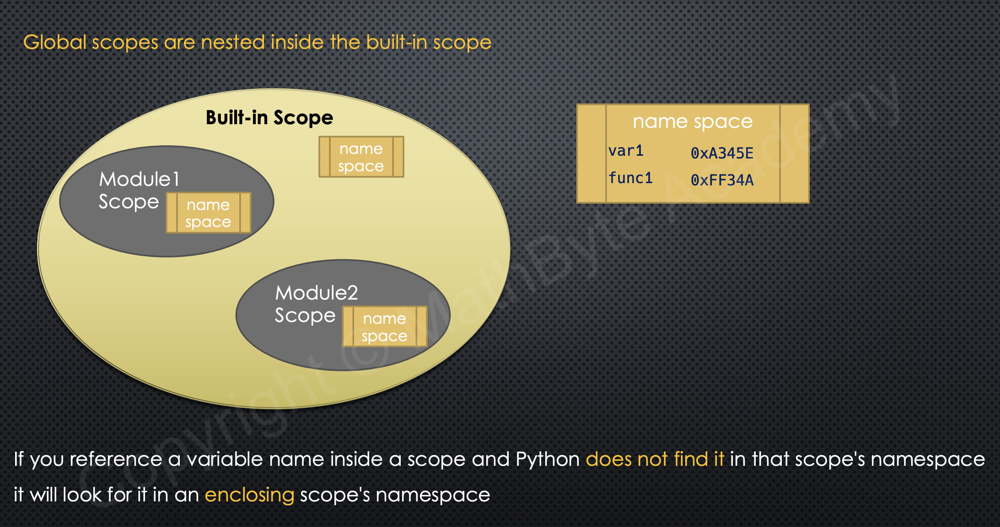

In [532]:
a =10

In [534]:
def myfunc(n):
    global a
    a=30
    c=n**2
    print(c)

In [535]:
a


10

In [536]:
myfunc(2)

4


In [537]:
a

30

- unlike Java and c++, variables still exist outside for, while etc loops

In [538]:
for x in range(5):
    x = x**x

In [539]:
x

256

# non local scopes
- for a nested function the scope in which the function itself is defined is known as the non local scope.
- just like `global` for global scope, we can access non local scope with `nonlocal `keyword.
- `nonlocal` keyword cannot enable the access to global scope. but it can access anything in the local scope

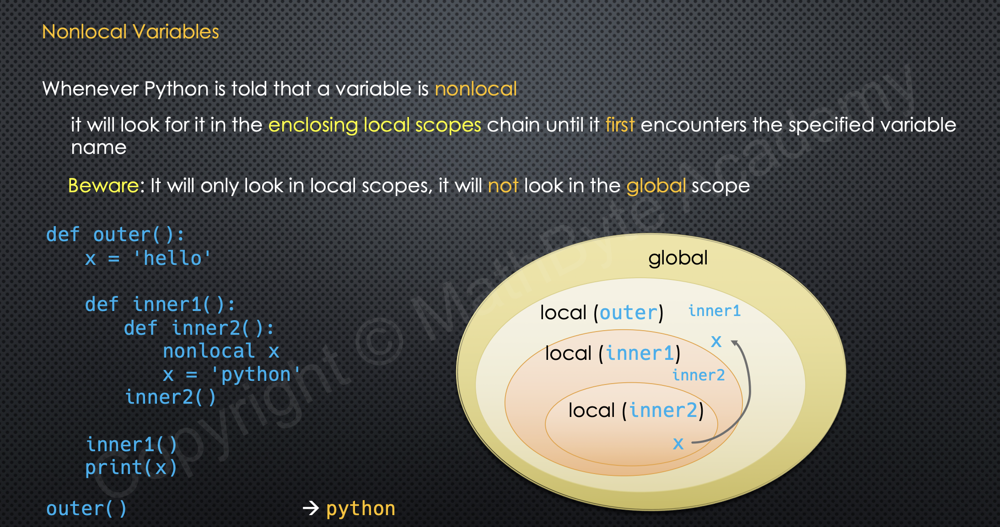

- it firsts looks inthe enclosing scope, if doesn't find there, it goes to the outer enclosing scope until it is not the gloabal scope

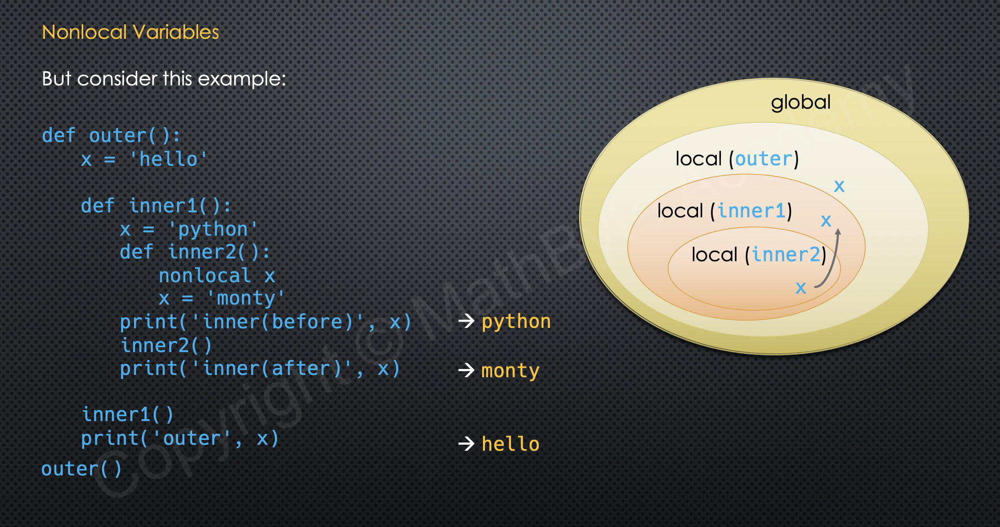

- If 2 consecutive scopes are using `nonlocal` then it is considered as the scope of the function enclosing the oute most non local definition vala scope.

In [540]:
def outer():
    x  =  'hello'
    def inner():
        print(x)
    inner()

In [541]:
outer()

hello


In [542]:
def outer():
    x  =  'hello'
    def inner1():
        def inner2():
            print(x)
        inner2()
    inner1()

In [543]:
outer()

hello


In [575]:
n = 1000000

def university():
    # global n
    n = 'uni'
    
    def college():
        # nonlocal n
        # n = 'clg'
        
        def branch():
            # nonlocal n
            # n = 'branch'
            
            def classroom():
                nonlocal n

                n = 'class'
                print(n)
            classroom()
            print(n)
        branch()
        print(n)
    
    college()
    print(n)


In [576]:
university()


class
class
class
class


In [578]:

x =93286234
def outer():
    # global x 
    x = 'monty'
    def inner():
        nonlocal x
        x = 'hello'
    inner()
    print(x)

In [579]:
outer()

hello


## Closures

- When a function has a nested function and it is using varibles from the local scope. 
- when such a nested function is returned, it actually also returns the parameters that are defined in the function. all of this all together is knnown as a closure.
- when such a return value is passed to the variable by running the outer function, the function gets executed first and the scope is destroyed. nut closure still exists.
- closure is also a type of scope only.

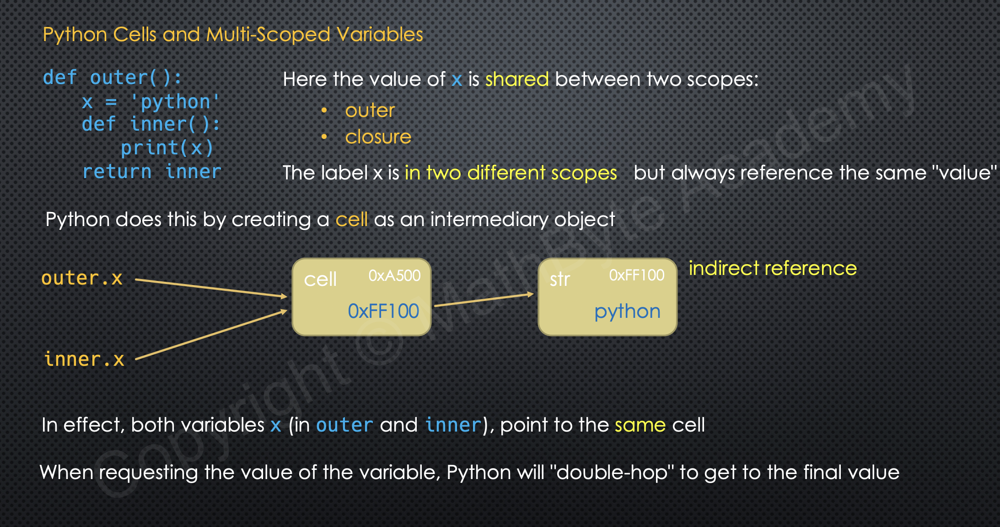

- so, closure = Function + extended scope containing the free variables

## modifying free variable

In [580]:
def counter():
    count  = 0

    def inc():
        nonlocal count
        count += 1
        return count
    
    return inc

In [581]:
f1  = counter()
f2 = counter()

In [582]:
f1.__closure__

(<cell at 0x108e307f0: int object at 0x10077a910>,)

In [583]:
f2.__closure__

(<cell at 0x108e30af0: int object at 0x10077a910>,)

In [584]:
f1()

1

In [585]:
f1()

2

In [586]:
f2()

1

- So, everytime the function is called, it creates a different scope. So, all the cell addresses for scope are different. 
- we can also have shared extended scope

In [594]:
def outer():
    count = 0

    def inc1():
        nonlocal count
        count += 1
        return count
    
    def inc2():
        nonlocal count
        count += 1
        return count
    
    return inc1, inc2


In [595]:
f1,f2 = outer()

In [596]:
f1()

1

In [597]:
f1()

2

In [598]:
f2()

3

In [599]:
def adder(n):
    def inner(x):
        return n+x
    return inner

In [608]:
f = adder(1)
f1 = adder(2)
f3 = adder(3)

In [609]:
f(2)

3

In [610]:
f1(3)

5

In [611]:
f3(4)

7

In [620]:
adders = []
for n in range(2,5):
    adders.append(lambda x: x+n)

here technically closure is not created

In [621]:
adders[0](10)

14

In [622]:
adders[2](10)

14

In [624]:
adders[0].__closure__

In [625]:
def aaaa():
    adders = []
    for n in range(2,5):
        adders.append(lambda x: x+n)
    return adders

In [631]:
l  =  aaaa()

In [632]:
l[0].__closure__

(<cell at 0x10917f970: int object at 0x10077a990>,)

In [633]:
l[1].__closure__

(<cell at 0x10917f970: int object at 0x10077a990>,)

- this is a bug that can be easily get rid of by defining another parameter and assigning it the value of x while defining the function.


In [634]:
def aaaa():
    adders = []
    for n in range(2,5):
        adders.append(lambda x, y=n: x+y)
    return adders

In [616]:
def outer():
    x = [1,2,3]
    print(hex(id(x)))
    def inner():
        y = x
        print(hex(id(y)))
    return inner

In [617]:
f1=outer()

0x1089d8f40


In [618]:
f1.__closure__

(<cell at 0x1090fc190: list object at 0x1089d8f40>,)

In [619]:
f1()

0x1089d8f40


## Closure application


In [635]:
class averager:
    def __init__(self) -> None:
        self.numbers = []
    
    def add(self, number):
        self.numbers.append(number)
        total = sum(self.numbers)
        n = len(self.numbers)
        return total/n

In [636]:
a = averager()

In [637]:
a.add(100)

100.0

In [638]:
a.add(50)

75.0

In [642]:
def averager():
    numbers = []
    def add(number):
        numbers.append(number)
        total = sum(numbers)
        n = len(numbers)
        return total/n

    return add

In [643]:
b = averager()

In [644]:
b(34)

34.0

In [645]:
b(345)

189.5

In [654]:
class timer:
    import time
    def __init__(self) -> None:
        self.start = time.perf_counter()

    def __call__(self):
        return time.perf_counter() - self.start

In [655]:
a = timer()

In [661]:
a()

21.891473083000164

`__call__()`, malkes the object name of that class a callable ...e.g. ^

In [662]:
from time import perf_counter

def timer():
    start = perf_counter()

    def capture():
        return perf_counter() - start
    
    return capture

In [663]:
t = timer()

In [664]:
t()

3.369921207995503

In [691]:
def counter():
    n = 1209
    def inner():
        nonlocal
        n +=8
        print (n)
        return n+8
    return inner

SyntaxError: invalid syntax (2775060302.py, line 4)

In [692]:
f = counter()

In [690]:
f()

UnboundLocalError: local variable 'n' referenced before assignment

In [766]:
def counter(a:'int'):
    n = 1209
    def inner():
        nonlocal n
        n= n+8
        print (n)
        return n+8
    return inner

In [767]:
counter.__annotations__

{'a': 'int'}

In [681]:
f1 = counter()

In [682]:
f1()

1217


1225

In [684]:
f1()

1233


1241

## closure applications (part-2)

In [693]:
def counter(fn):
    cnt = 0
    def inner(*args, **kwargs):
        nonlocal cnt
        cnt += 1
        print('{0} has been called {1} times'.format(fn.__name__, cnt))
        return fn(*args, **kwargs)
    return inner


In [695]:
def add(a,b):
    return a+b

def mul(a,b):
    return a*b

In [696]:
a = counter(add)

In [699]:
a(2,3)

add has been called 3 times


5

In [700]:
b = counter(mul)

In [702]:
b(2,5)

mul has been called 2 times


10

- Dummy variables are conventionally named as `_` simply, we don't care about them, its used when we are unpacking variables
- `*_` is used for extended unpacking

In [704]:
a = (10,20,30)
a1,b1,c1 = (10,20,30)


In [705]:
a1

10

In [706]:
x = 1,2,3,4,5,6,7,8

In [707]:
a1,a2,*_,a8 = x

In [708]:
a1

1

In [709]:
a2

2

In [710]:
a8

8

In [711]:
_

[3, 4, 5, 6, 7]

In [712]:
a = 1,2,3

In [713]:
id(a)

4449385152

In [714]:
a += 4,5,6

In [715]:
a

(1, 2, 3, 4, 5, 6)

In [716]:
id(a)

4447768096

## decorators

In general a decorator function:

- takes a function as an argument
- returns a closure
- The closure usually accepts any combination of parameters
- runs some code in the inner function (closure)
- `@` is used to mention decorators

In [735]:
def counter(fn):
    count = 0
    def inner(*args: 'soemthings',**kwargs: 'some other things') -> 'It returns a function': 
        """ hello, you are into a decorator
        Hope you understand me well"""
        nonlocal count
        count+=1
        print('{0} is called {1} time(s)'.format(fn.__name__, count))
        return fn(*args,**kwargs)
    return inner

In [736]:
@counter
def add(a,b):
    return a+b

In [737]:
add(9,3)

add is called 1 time(s)


12

In [738]:
add.__name__

'inner'

In [739]:
help(add)

Help on function inner in module __main__:

inner(*args: 'soemthings', **kwargs: 'some other things') -> 'It returns a function'
    hello, you are into a decorator
    Hope you understand me well



In [746]:
def counter(fn):
    count = 0
    def inner(*args: 'soemthings',**kwargs: 'some other things') -> 'It returns a function': 
        """ hello, you are into a decorator
        Hope you understand me well"""
        nonlocal count
        count+=1
        print('{0} is called {1} time(s)'.format(fn.__name__, count))
        inner.__name__ = fn.__name__
        inner.__doc__=fn.__doc__
        inner.__annotations__=fn.__annotations__
        return fn(*args,**kwargs)
    return inner

In [747]:
@counter
def add(a:'int',b:'int')->'int':
    'you are into the add fn'
    return a+b

In [749]:
add(99,3)

add is called 2 time(s)


102

In [771]:
add.__annotations__


{'a': 'int', 'b': 'int', 'return': 'int'}

In [750]:
add.__name__

'add'

In [751]:
help(add)

Help on function add in module __main__:

add(*args, **kwargs) -> 'int'
    you are into the add fn



- It still isn't able to change the function signature
- to fiux the metadata, `functools` module has a `wraps` function that we can use to fix the metadata of our inner function is the decorator
- wraps itself is a decorator

In [761]:
from functools import wraps

def counter(fn):
    count = 0
    # @wraps(fn)
    def inner(*args: 'soemthings',**kwargs: 'some other things') -> 'It returns a function': 
        """ hello, you are into a decorator
        Hope you understand me well"""
        nonlocal count
        count+=1
        print('{0} is called {1} time(s)'.format(fn.__name__, count))
        return fn(*args,**kwargs)
    inner = wraps(fn)(inner)
    return inner

In [762]:
@counter
def add(a:'int',b:'int')->'int':
    'you are into the add fn'
    return a+b

In [763]:
help(add)

Help on function add in module __main__:

add(a: 'int', b: 'int') -> 'int'
    you are into the add fn



## Decorator applications

In [772]:
def timed(fn):
    from time import perf_counter
    from functools import wraps

    @wraps(fn)
    def inner(*args, **kwargs):
        start = perf_counter()
        result = fn(*args, **kwargs)
        end = perf_counter()
        elapsed  = end - start

        _args = [str(x) for x in [*args]]
        _kwargs = ['{0} : {1}'.format(k,v) for (k,v) in {**kwargs}]
        all_args = _args + _kwargs
        args_str = ','.join(all_args)

        print('{0}({1}) took {2:.6f} seconds to execute'.format(fn.__name__, args_str, elapsed))
        return result
    
    return inner


fibonacci calculating function
- recursion
- loop
- reduce

In [787]:
# @timed
def fib_rec(n):
    if n==1 or n == 2:
        return 1
    else:
        return fib_rec(n-1)+fib_rec(n-2)

In [788]:
fib_rec(5)

5

In [789]:
@timed
def fib_rec_timed(n):
    return fib_rec(n)

In [790]:
fib_rec_timed(6)

fib_rec_timed(6) took 0.000003 seconds to execute


8

In [791]:
fib_rec_timed(25)

fib_rec_timed(25) took 0.010080 seconds to execute


75025

In [792]:
fib_rec_timed(30)

fib_rec_timed(30) took 0.112095 seconds to execute


832040

In [793]:
fib_rec_timed(35)

fib_rec_timed(35) took 1.185295 seconds to execute


9227465

In [794]:
fib_rec_timed(36)

fib_rec_timed(36) took 1.901151 seconds to execute


14930352

In [832]:
@timed
def fib_loop(n):
    fib1= 1
    fib2 = 1
    res =1
    for i in range(3,n+1):
        # res = fib1+fib2
        fib1,fib2 = fib2, fib1+fib2               #Coz it's python
        # fib1 = res
    return fib2

In [834]:
fib_loop(4)

fib_loop(4) took 0.000001 seconds to execute


3

In [805]:
l = [i for i in range(2,3)]

In [839]:
l = [1,2,3,4,5,6]
f = reduce(lambda x,y: x+y, l
)
print(f)

21


In [847]:
@timed
def fib_reduce(n):
    initial = (1,0)
    dumy = range(n)
    fib_n=reduce(lambda prev,n:(prev[0]+prev[1], prev[0]) ,initial, dumy )
    return fib_n[0]

In [848]:
fib_reduce(4)

fib_reduce(4) took 0.000005 seconds to execute


1

# ***`Look later, after reduce`***

## Decorator application(logger, stacked decorators)

In [860]:
def logged(fn):
    from functools import wraps
    from datetime import datetime, timezone

    @wraps(fn)
    def inner(*args, **kwargs):
        results = fn(*args,**kwargs)
        run_dt = datetime.now(timezone.utc)
        print('{0}: called {1}'.format(run_dt, fn.__name__))
        return results
    
    return inner

In [861]:
@logged
def func1():
    pass

In [862]:
@logged
def func2():
    pass

In [863]:
func1()

2023-07-24 13:38:00.925703+00:00: called func1


In [864]:
def timed(fn):
    from time import perf_counter
    from functools import wraps

    @wraps(fn)
    def inner(*args, **kwargs):
        start = perf_counter()
        result = fn(*args, **kwargs)
        end = perf_counter()
        elapsed  = end - start
        print('{0} ran for {1:.6f} seconds'.format(fn.__name__, elapsed))
        return result
    
    return inner

In [865]:
def fact(n):
    from operator import mul
    from functools import reduce

    return reduce(mul, range(1,n+1))

In [866]:
fact(5)

120

In [867]:
@logged
@timed
def fact(n):
    from operator import mul
    from functools import reduce

    return reduce(mul, range(1,n+1))

In [868]:
fact(5)

fact ran for 0.000005 seconds
2023-07-24 13:38:03.955729+00:00: called fact


120

In [874]:
def dec1(fn):
    
    def inner():
        print('running dec1')
        return fn()
    return inner


In [875]:
def dec2(fn):
    
    def inner():
        print('running dec2')
        return fn()
    return inner

In [876]:
@dec1
@dec2
def my_func():
    print('Running my func')


In [877]:
f = my_func() 
# f = dec1(dec2(fn()))

running dec1
running dec2
Running my func


In [879]:
def dec1(fn):
    
    def inner():
        result = fn()
        print('running dec1')
        return result
    return inner


In [880]:
def dec2(fn):
    
    def inner():
        result = fn()
        print('running dec2')
        return result
    return inner

In [881]:
@dec1
@dec2
def my_func():
    print('Running my func')

In [882]:
my_func()

Running my func
running dec2
running dec1


## Memoization

- cacheing can be used to memoize a function

In [896]:
class fibonacci:
    def __init__(self) -> None:
        self.cache = dict()

    def fib(self, n):
        if n not in self.cache:
            print('running fib for n = {0}'.format(n))
            self.cache[n] = 1 if n<3 else self.fib(n-1) + self.fib(n-2)
        return self.cache[n]
        

In [897]:
f = fibonacci()

In [898]:
f.fib(5)

running fib for n = 5
running fib for n = 4
running fib for n = 3
running fib for n = 2
running fib for n = 1


5

In [903]:
def fib_momoize_closure():
    cache = dict()

    def fib(n):
        if n not in cache:
            print('running fib for n = {0}'.format(n))
            cache[n] = 1 if n<3 else fib(n-1) + fib(n-2)
        return cache[n]
    
    return fib

In [904]:
f = fib_momoize_closure()

In [905]:
f(5)

running fib for n = 5
running fib for n = 4
running fib for n = 3
running fib for n = 2
running fib for n = 1


5

In [918]:
def memoize(fn):
    from functools import wraps
    cache=dict()
    @wraps(fn)
    def inner(n):
        if n not in cache:
            print('running {0} for n = {1}'.format(fn.__name__, n))
            cache[n] = fn(n)
        return cache[n]
    
    return inner

In [919]:
@memoize
def fib(n : 'int') -> 'int':
    """It calculates fibnocci series element no. n"""
    return 1 if n<3 else fib(n-1)+ fib(n-2)

In [920]:
fib(5)

running fib for n = 5
running fib for n = 4
running fib for n = 3
running fib for n = 2
running fib for n = 1


5

In [921]:
help(fib)

Help on function fib in module __main__:

fib(n: 'int') -> 'int'
    It calculates fibnocci series element no. n



`lru_cache can be used for cacheing`

In [922]:
from functools import lru_cache

In [ ]:
@lru_cache
def fib(n : 'int') -> 'int':
    """It calculates fibnocci series element no. n"""

    
    return 1 if n<3 else fib(n-1)+ fib(n-2)

## Decorator factories

In [930]:
def timed(fn):
    from time import perf_counter
    from functools import wraps

    @wraps(fn)
    def inner(*args, **kwargs):
        total_time=0
        for i in range(10):
            start = perf_counter()
            result = fn(*args, **kwargs)
            total_time += (perf_counter() - start)
        avg = total_time/10
        print('Average elapsed time is {0}'.format(avg))
        return result
    
    return inner

In [931]:
@timed
def s_add(a,b):
    return a+b

In [932]:
s_add(3,2)

Average elapsed time is 1.3329845387488605e-07, for n = 4


5

In [935]:
def timed(fn,n):
    from time import perf_counter
    from functools import wraps

    @wraps(fn)
    def inner(*args, **kwargs):
        total_time=0
        for i in range(n):
            start = perf_counter()
            result = fn(*args, **kwargs)
            total_time += (perf_counter() - start)
        avg = total_time/n
        print('Average elapsed time is {0}, for n = {1}'.format(avg,n))
        return result
    
    return inner

In [936]:
def s_add(a,b):
    return a+b

s_add = timed(s_add, 15)

In [937]:
s_add(56,243)

Average elapsed time is 1.7786708970864613e-07, for n = 15


299

In [938]:
# @timed(15)
# def xyx():
#     pass

# is eq. To 
 
#  timed(15)(xyx)
# so timed(n) should return a decorator

In [952]:
def timed(n):

    def dec(fn):
        @wraps(fn)
        def inner(*args, **kwargs):
            total_time=0
            for i in range(n):
                start = perf_counter()
                result = fn(*args, **kwargs)
                total_time += (perf_counter() - start)
            avg = total_time/n
            print('Average elapsed time is {0}, for n = {1}'.format(avg,n))
            return result
        return inner
    return dec
        

In [953]:
@timed(9025)
def s_add(a,b):
    return a+b

In [954]:
s_add(4,5)

Average elapsed time is 1.4327717054934547e-07, for n = 9025


9

## Decorator class

In [956]:
def dec_gen(a,b):
    def dec(fn):
        def iner(*args, **kwargs):
            print('running {0} with a={1}, b={2}'.format(fn.__name__, a,b))
            # fn(*args,**kwargs)
            return fn(*args,**kwargs)
        return iner
    return dec


In [957]:
@dec_gen(10,20)
def hi_func(s):
    print('hello, {0}'.format(s))

In [958]:
hi_func('Tanay')

running hi_func with a=10, b=20
hello, Tanay


In [966]:

class MyClass:
    def __init__(self,a,b) -> None:
        self.a = a
        self.b=b

    def __call__(self, c) -> Any:
        print(self.a,self.b,c)



In [964]:
def hi_func(s):
    print('hello, {0}'.format(s))

In [963]:
g = MyClass(1,2)

In [961]:
g(fib)

1 2 87


In [967]:
class MyClass:
    def __init__(self,a,b) -> None:
        self.a = a
        self.b=b

    def __call__(self, fn) -> Any:
        def iner(*args, **kwargs):
            print('running {0} with a={1}, b={2}'.format(fn.__name__, self.a,self.b))
            # fn(*args,**kwargs)
            return fn(*args,**kwargs)
        return iner

In [969]:
@MyClass(10,20)
def hi_func(s):
    print('hello, {0}'.format(s))

In [970]:
hi_func('world')

running hi_func with a=10, b=20
hello, world


- Monkey patching

we can modify our code during runtime- it's called monkey patching

In [971]:
from fractions import Fraction

In [972]:
f = Fraction(3,5)

In [978]:
Fraction.speak = lambda self, message: 'fraction says : {0}'.format(message)

In [981]:
f.speak('Hellooooooo')

'fraction says : Hellooooooo'

In [985]:
Fraction.is_integarl = lambda self:self.denominator == 1

In [986]:
f.is_integarl()

False

In [987]:
f2 = Fraction(3,1)

In [988]:
f2.is_integarl()

True

In [1024]:
class webseries:
    def __init__(self, name, xyz, duration, views, *genre):
        self._name = name
        self._genre = genre
        self._budget = xyz
        self._duration = duration
        self._views = views
    
    @property
    def budget(self):
        return self._budget
    
    @property
    def genre(self):
        return self._genre
    
    @property
    def name(self):
        return self._name
    
    @property
    def duration(self):
        return self._duration
    
    @property
    def views(self):
        return self._views
    
    @name.setter
    def name(self, new_name):
        self._name = new_name

    @views.setter
    def views(self, val):
        self._views = val

    def is_scary(self):
        for i in self.genre:
            if i == 'horror':
                return True
        return False
    
    def is_long(self):
        return True if self.duration > 8 else False
    
    def is_hit(self):
        return True if self.views > 50000000 else False
    
    def is_adult(self):
        for i in self.genre:
            if i == 'adult':
                return True
        return False
    
    def is_watchable(self):
        return self.is_hit() and not self.is_adult() and self.something()
     
    def something(self):
        import time
        start = time.perf_counter()
        for i in range(100000000):
            a=i
        end  = time.perf_counter()
        print(end-start)
        return True
    
    def prime_genre(self):
        return self.genre and self.genre[0]
    
    def earnings(self):
        return 


In [1029]:
def dec_class(cls):
    cls.speak = lambda self, msg: '{0} says {1}'.format(self.__class__.__name__, msg)

    return cls

In [1030]:
webseries = dec_class(webseries)

In [1031]:
manifest = webseries('Manifest', '65 MILLION', '2 days', '7million', 'Sci-fi')

In [1033]:
manifest.speak("hi I'm Manifest")

"webseries says hi I'm Manifest"

In [1034]:
from datetime import datetime, timezone
def debug_info(cls):
    def info(self):
        results = []
        results.append('time: {0}'.format(datetime.now(timezone.utc)))
        results.append('class: {0}'.format(self.__class__.__name__))
        results.append('id: {0}'.format(hex(id(self))))
        
        if vars(self):
            for k, v in vars(self).items():
                results.append('{0}: {1}'.format(k, v))
        
        # we have not covered lists, the extend method and generators,
        # but note that a more Pythonic way to do this would be:
        #if vars(self):
        #    results.extend('{0}: {1}'.format(k, v) 
        #                   for k, v in vars(self).items())
        
        return results
    
    cls.debug = info
    
    return cls

In [1035]:
@debug_info
class Person:
    def __init__(self, name, birth_year):
        self.name = name
        self.birth_year = birth_year
        
    def say_hi():
        return 'Hello there!'

In [1036]:
p1 = Person('John', 1939)

In [1037]:
p1.debug()

['time: 2023-07-25 08:57:39.385331+00:00',
 'class: Person',
 'id: 0x10971c280',
 'name: John',
 'birth_year: 1939']

In [1038]:
@debug_info
class Automobile:
    def __init__(self, make, model, year, top_speed_mph):
        self.make = make
        self.model = model
        self.year = year
        self.top_speed_mph = top_speed_mph
        self.current_speed = 0
    
    @property
    def speed(self):
        return self.current_speed
    
    @speed.setter
    def speed(self, new_speed):
        self.current_speed = new_speed

In [1039]:
s = Automobile('Ford', 'Model T', 1908, 45)

In [1040]:
s.debug()

['time: 2023-07-25 08:58:10.587246+00:00',
 'class: Automobile',
 'id: 0x10971c3d0',
 'make: Ford',
 'model: Model T',
 'year: 1908',
 'top_speed_mph: 45',
 'current_speed: 0']

In [1046]:
from math import sqrt

In [1042]:


class Point:
    def __init__(self, x, y):
        self.x = x
        self.y = y
        
    def __abs__(self):
        return sqrt(self.x**2 + self.y**2)
    
    def __eq__(self, other):
        if isinstance(other, Point):
            return self.x == other.x and self.y == other.y
        else:
            return NotImplemented
            
    def __lt__(self, other):
        if isinstance(other, Point):
            return abs(self) < abs(other)
        else:
            return NotImplemented
        
    def __repr__(self):
        return '{0}({1},{2})'.format(self.__class__.__name__, self.x, self.y)

In [1043]:
p1, p2, p3 = Point(2, 3), Point(2, 3), Point(0,0)

In [1044]:
p4 = Point(1, 2)

In [1047]:
abs(p1), abs(p4), p1 < p4

(3.605551275463989, 2.23606797749979, False)

In [1048]:
def complete_ordering(cls):
    if '__eq__' in dir(cls) and '__lt__' in dir(cls):
        cls.__le__ = lambda self, other: self < other or self == other
        cls.__gt__ = lambda self, other: not(self < other) and not (self == other)
        cls.__ge__ = lambda self, other: not (self < other)
    return cls

In [1049]:
class Point:
    def __init__(self, x, y):
        self.x = x
        self.y = y
        
    def __abs__(self):
        return sqrt(self.x**2 + self.y**2)
    
    def __eq__(self, other):
        if isinstance(other, Point):
            return self.x == other.x and self.y == other.y
        else:
            return NotImplemented
            
    def __lt__(self, other):
        if isinstance(other, Point):
            return abs(self) < abs(other)
        else:
            return NotImplemented
        
    def __repr__(self):
        return '{0}({1},{2})'.format(self.__class__, self.x, self.y)

In [1050]:
@complete_ordering
class Grade:
    def __init__(self, score, max_score):
        self.score = score
        self.max_score = max_score
        self.score_percent = round(score / max_score * 100)
     
    def __repr__(self):
        return 'Grade({0}, {1})'.format(self.score, self.max_score)
    
    def __eq__(self, other):
        if isinstance(other, Grade):
            return self.score_percent == other.score_percent
        else:
            return NotImplemented
    
    def __lt__(self, other):
        if isinstance(other, Grade):
            return self.score_percent < other.score_percent
        else:
            return NotImplemented

In [1051]:
g1 = Grade(10, 100)
g2 = Grade(20, 30)
g3 = Grade(5, 50)

In [1052]:
g1 <= g2, g1 == g3, g2 > g3

(True, True, True)

In [1053]:
from functools import total_ordering

In [1054]:
@total_ordering
class Grade:
    def __init__(self, score, max_score):
        self.score = score
        self.max_score = max_score
        self.score_percent = round(score / max_score * 100)
     
    def __repr__(self):
        return 'Grade({0}, {1})'.format(self.score, self.max_score)
    
    def __eq__(self, other):
        if isinstance(other, Grade):
            return self.score_percent == other.score_percent
        else:
            return NotImplemented
    
    def __lt__(self, other):
        if isinstance(other, Grade):
            return self.score_percent < other.score_percent
        else:
            return NotImplemented

## Decorator Applications

- In Python overridding a function with same name but different signature is not possible.
- Because in python we do not have types specifications


In [1057]:
from html import escape


print("<pre>")

\n \


In [1058]:
from html import escape

In [1065]:
def html_escape(arg):
    return escape(str(arg))

def html_int(a):
    return '{0}(<i>{1}</i>)'.format(a,str(hex(a)))

def html_real(a):
    return '(0:.2f)'.format(round(a,2))

def html_str(s):
    return html_escape(s).replace('\n', '<br/>\n')

def html_list(l):
    items = ('<li>{0}</li>'.format(html_escape(item)) for item in l)
    return '<ul>\n' + '\n'.join(items) + '\n</ul>'

def html_dict(d):
    items = ('<li>{0}={1}<\li>'.format(k,v) for k,v in d.items())

In [1066]:
print(html_str("""This is
a multi-line string
with special characters : 10<1000"""))

This is<br/>
a multi-line string<br/>
with special characters : 10&lt;1000


In [1067]:
print(html_int(255))

255(<i>0xff</i>)


In [1068]:
print(html_escape(3+10j))

(3+10j)


In [1069]:
from decimal import Decimal

In [1070]:
def htmlize(arg):
    if isinstance(arg, int):
        return html_int(arg)
    elif isinstance(arg, float) or isinstance(arg, Decimal):
        return html_real(arg)
    elif isinstance(arg, str):
        return html_str(arg)
    elif isinstance(arg, list) or isinstance(arg, tuple):
        return html_list(arg)
    elif isinstance(arg, dict):
        return html_dict(arg)
    else:
        return html_escape(arg)

In [1071]:
htmlize(100)

'100(<i>0x64</i>)'

In [1072]:
htmlize("""hello
     how 
     are <><><>M<>""")

'hello<br/>\n     how <br/>\n     are &lt;&gt;&lt;&gt;&lt;&gt;M&lt;&gt;'

In [1075]:
print(htmlize((1,2,3)))

<ul>
<li>1</li>
<li>2</li>
<li>3</li>
</ul>


In [1076]:
print(htmlize(["""first element is 
a multi-line string""", (1, 2, 3)]))

<ul>
<li>first element is 
a multi-line string</li>
<li>(1, 2, 3)</li>
</ul>


In [1077]:
def html_list(l):
    items = ['<li>{0}</li>'.format(htmlize(item)) for item in l]
    return '<ul>\n' + '\n'.join(items) + '\n</ul>'

def html_dict(d):
    items = ['<li>{0}={1}</li>'.format(html_escape(k), htmlize(v)) for k, v in d.items()]
    return '<ul>\n' + '\n'.join(items) + '\n</ul>'

In [1078]:
print(htmlize(["""first element is 
a multi-line string""", (1, 2, 3)]))

<ul>
<li>first element is <br/>
a multi-line string</li>
<li><ul>
<li>1(<i>0x1</i>)</li>
<li>2(<i>0x2</i>)</li>
<li>3(<i>0x3</i>)</li>
</ul></li>
</ul>


# Tuples

In [1079]:
t = (1,2,3,4,45)

In [1080]:
a,b,c,d,e = t

In [1081]:
a


1

In [1082]:
c

3

In [1083]:
a,b,*_,e = t

In [1084]:
a

1

In [1085]:
e

45

In [1087]:
_

[3, 4]

- `enumerate()` returns the elements of tuples as key-value pairs

In [1088]:
Ahmedabad = 'Gj', 2_40_000
Surat = 'Gj', 2_50_876
Pune = 'Mh', 3_00_000

In [1089]:
cities = [Ahmedabad,Surat,Pune]

In [1094]:
for index, items in enumerate(cities):
    print(index, items)

0 ('Gj', 240000)
1 ('Gj', 250876)
2 ('Mh', 300000)


TypeError: 'enumerate' object is not subscriptable

In [1095]:
from random import uniform
from math import sqrt

def random_shot(radius):
    random_x= uniform(-radius, radius)
    random_y= uniform(-radius, radius)

    if sqrt(random_x**2 + random_y**2)<= radius:
        is_in_circle = True
    else:
        is_in_circle = False
    
    return random_x,random_y, is_in_circle

In [1100]:
num_attempts = 1_00_00000
count_inside = 0
for i in range(num_attempts):
    *_, is_in_circle = random_shot(1)
    if is_in_circle:
        count_inside += 1

print(f'Pi is approximately: {4 * count_inside / num_attempts}')

Pi is approximately: 3.1411356
